In [ ]:
# !pip install git+https://github.com/qubvel/segmentation_models
# %env SM_FRAMEWORK = tf.keras

In [1]:
# from segmentation_models import Unet
# import segmentation_models as sm
from keras.preprocessing import image
from keras.engine import Layer
from keras.activations import softmax
from keras.layers import Softmax
from keras.optimizers import Adam
from keras.layers import Conv2D, UpSampling2D, InputLayer, Conv2DTranspose, Input, Reshape, merge, Concatenate
from keras.layers import MaxPool2D, Activation, Dense, Dropout, Flatten
from keras.layers.normalization import BatchNormalization
from keras.models import Sequential, Model
from tensorflow.keras.losses import CategoricalCrossentropy
from keras.preprocessing.image import ImageDataGenerator, array_to_img, img_to_array, load_img
import keras.backend as K
import keras
import tensorflow as tf
from skimage.color import rgb2lab, lab2rgb, rgb2gray, gray2rgb
import numpy as np
import os
import random
import matplotlib.pyplot as plt
import PIL
from PIL import Image


%matplotlib inline

In [2]:
seed = 42
BIN_LENGTH = 10
BIN_CENTERS = np.array(range(-105, 106, BIN_LENGTH))
BIN_EDGES = (BIN_CENTERS[:-1] + BIN_CENTERS[1:]) / 2
NUM_BINS = len(BIN_EDGES) + 1
RZHANG_LOSS_WEIGHT = 1000
train_dir = '../input/div2k-dataset/DIV2K_train_HR/DIV2K_train_HR/'
input_shape = (64, 64, 1)
_height, _width = 64, 64
data_size = 200

In [3]:

def plot_frequencies(arr):
    x_temp = np.arange(0, len(arr))
    y_temp = np.array(arr)

    plt.title("Line graph")
    plt.xlabel("X axis")
    plt.ylabel("Y axis")
    plt.plot(x_temp, y_temp, color="green")
    plt.show()


def plot_imgs(bw, arr):
    n = 0
    fig = plt.figure(figsize=(16, 16))
    fig.subplots_adjust(left=0, right=1, bottom=0,
                        top=1, hspace=0.05, wspace=0.05)
    i = 0
    for i in range(min(len(arr), 64)):
        ax = fig.add_subplot(8, 8, i + 1, xticks=[], yticks=[])
        i = i+1
        cur = np.zeros((_height, _height, 3))
        cur[:, :, 0] = bw[i-1][:, :, 0]
        cur[:, :, 1:] = arr[i-1]
        cur = lab2rgb(cur)
        plt.imshow(cur, cmap='gray')
    plt.show()

In [4]:
# Data Preprocessing


def encode_ab(ab_channels):
    num_images = ab_channels.shape[0]
    img_height = ab_channels.shape[1]
    img_width = ab_channels.shape[2]

    one_hot = np.zeros((num_images, img_height, img_width,
                       NUM_BINS * NUM_BINS), dtype=np.float64)

    ab_bin_freqs = np.zeros(NUM_BINS * NUM_BINS, dtype=np.float64)

    a_bins = np.digitize(ab_channels[:, :, :, 0], BIN_EDGES)
    b_bins = np.digitize(ab_channels[:, :, :, 1], BIN_EDGES)

    ab_bins = a_bins * NUM_BINS + b_bins

    for n in range(num_images):
        for i in range(img_height):
            for j in range(img_width):
                one_hot[n, i, j, ab_bins[n, i, j]] = 1
                ab_bin_freqs[ab_bins[n, i, j]] += 1
        if(n % 100 == 0):
            print("Encoding image : ", n)

    return one_hot, ab_bin_freqs


def decode_ab(n_one_hots):
    ab_channels = np.zeros(
        (n_one_hots.shape[0], n_one_hots.shape[1], n_one_hots.shape[2], 2))

    for n in range(n_one_hots.shape[0]):
        for i in range(n_one_hots.shape[1]):
            for j in range(n_one_hots.shape[2]):
                index = np.argmax(n_one_hots[n, i, j])
                a_index = index // NUM_BINS
                b_index = index % NUM_BINS

                ab_channels[n, i, j, 0] = BIN_CENTERS[a_index]
                ab_channels[n, i, j, 1] = BIN_CENTERS[b_index]

    return ab_channels

In [5]:

def create_dataset_v2(dir_path, l_size, ab_size, idx):
    file_list = os.listdir(dir_path)
    num_images = len(file_list)

    l_channel = np.zeros((num_images, l_size, l_size, 1))
    ab_channels = np.zeros((num_images, ab_size, ab_size, 2))

    image_index = 0

    for i, f in enumerate(file_list):
        image_path = os.path.join(dir_path, f)
        image = Image.open(image_path).convert("RGB")
        image = image.resize((l_size, l_size))
        l = rgb2lab(image)*1.0
        ab = l[:, :, 1:]
        l = l[:, :, 0:1]
        l_channel[image_index] = l
        ab_channels[image_index] = ab
        image_index += 1
        if(image_index % 100 == 0):
            print("Processing image : ", image_index)
        if(image_index == idx):
            break

    l_channel = l_channel[0:image_index, :, :, :]
    ab_channels = ab_channels[0:image_index]

    ab_onehot, ab_bin_frequencies = encode_ab(ab_channels)
    return l_channel, ab_onehot, ab_bin_frequencies


def get_ab_bin_weights(AB_BIN_FREQS):
    AB_BIN_FREQS = [float(c) / sum(AB_BIN_FREQS) for c in AB_BIN_FREQS]

    AB_BIN_WEIGHTS = [0.5 * c + 0.5 / len(AB_BIN_FREQS) for c in AB_BIN_FREQS]
    AB_BIN_WEIGHTS = [1.0 / w for w in AB_BIN_WEIGHTS]

    AB_BIN_WEIGHTS = [w / sum(AB_BIN_WEIGHTS) for w in AB_BIN_WEIGHTS]

    return AB_BIN_WEIGHTS

Processing image :  100
Processing image :  200
Encoding image :  0
Encoding image :  100


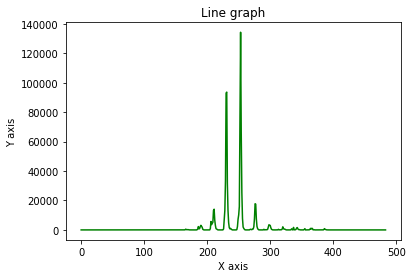

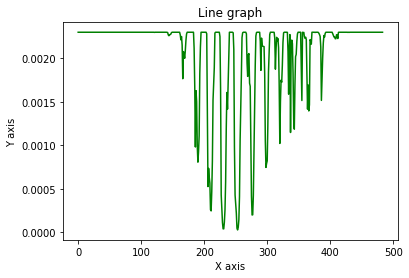

In [6]:
"""Getting data and bin weights"""
train_ls, train_abs_onehot, train_ab_bin_frequencies = create_dataset_v2(
    train_dir, _height, _height, data_size)

train_ab_bin_frequencies = train_ab_bin_frequencies.astype('int32')
train_ab_f = train_ab_bin_frequencies.tolist()
plot_frequencies(train_ab_bin_frequencies)
AB_BIN_WEIGHTS = get_ab_bin_weights(train_ab_f)
plot_frequencies(AB_BIN_WEIGHTS)


In [7]:
print(max(AB_BIN_WEIGHTS),min(AB_BIN_WEIGHTS))

0.0023014023135631526 2.8656082573986926e-05


In [8]:
"""Weighted categorical crossentropy """


def custom_loss_rebalancing_segments(y_true, y_pred):
    y_pred_clipped = K.clip(y_pred, K.epsilon(), None)

    img_height = y_true.shape[1]
    img_width = y_true.shape[2]

    loss = -K.sum(y_true * K.log(y_pred_clipped), axis=3)

    bin_indices = K.argmax(y_true, axis=3)
    weights = K.gather(reference=AB_BIN_WEIGHTS, indices=bin_indices)

    loss = RZHANG_LOSS_WEIGHT * K.sum(loss * weights)

    loss += K.sum((y_pred[:, :-1, :, :] - y_pred[:, 1:, :, :]) ** 2)
    loss += K.sum((y_pred[:, :, :-1, :] - y_pred[:, :, 1:, :]) ** 2)

    return loss

In [9]:
def createModel(_height):
    def conv_block(input, num_filters):
        x = Conv2D(num_filters, 3, padding="same")(input)
        x = BatchNormalization()(x)
        x = Activation("relu")(x)

        x = Conv2D(num_filters, 3, padding="same")(x)
        x = BatchNormalization()(x)
        x = Activation("relu")(x)

        return x


    def encoder_block(input, num_filters):
        x = conv_block(input, num_filters)
        p = MaxPool2D((2, 2))(x)
        return x, p


    def decoder_block(input, skip_features, num_filters):
        x = Conv2DTranspose(num_filters, (2, 2), strides=2, padding="same")(input)
        x = Concatenate()([x, skip_features])
        x = conv_block(x, num_filters)
        return x


    def build_unet(input_shape):
        inputs = Input(input_shape)

        s1, p1 = encoder_block(inputs, 64)
        s2, p2 = encoder_block(p1, 128)
        s3, p3 = encoder_block(p2, 256)
        s4, p4 = encoder_block(p3, 512)

        b1 = conv_block(p4, 1024)

        d1 = decoder_block(b1, s4, 1024)
        d2 = decoder_block(d1, s3, 512)
        d3 = decoder_block(d2, s2, 512)
        d4 = decoder_block(d3, s1, 484)

        #outputs = Conv2D(2, 1, padding="same", activation="tanh")(d4)
        outputs = tf.keras.layers.Softmax(axis=3)(d4)
        model = Model(inputs, outputs, name="U-Net")
        return model
    
    model=build_unet(input_shape)
    print(model.summary())
    model.compile(optimizer='rmsprop', loss=custom_loss_rebalancing_segments)
    return model


In [10]:
my_callbacks = [
    tf.keras.callbacks.EarlyStopping(
        patience=11, restore_best_weights=True, monitor='loss', verbose=1),
    tf.keras.callbacks.ReduceLROnPlateau(
        factor=0.22, patience=3, monitor='loss', verbose=1, min_lr=0.0001)
    
]
checkpoint=tf.keras.callbacks.ModelCheckpoint(filepath='checkpoint_div2k.h5',
                                       min_lr=0.0001,
                                       save_best_only=True,
                                       restore_best_weights=True,
                                       monitor='loss',
                                       verbose=1)

In [11]:
model = createModel(_height)

Model: "U-Net"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_1 (InputLayer)            [(None, 64, 64, 1)]  0                                            
__________________________________________________________________________________________________
conv2d (Conv2D)                 (None, 64, 64, 64)   640         input_1[0][0]                    
__________________________________________________________________________________________________
batch_normalization (BatchNorma (None, 64, 64, 64)   256         conv2d[0][0]                     
__________________________________________________________________________________________________
activation (Activation)         (None, 64, 64, 64)   0           batch_normalization[0][0]        
______________________________________________________________________________________________

In [12]:
model.compile(optimizer='rmsprop', loss=custom_loss_rebalancing_segments)
# model.compile(optimizer='rmsprop',loss='categorical_crossentropy')

In [13]:
x_train = tf.convert_to_tensor(train_ls, dtype=tf.float32)
y_train = tf.cast(train_abs_onehot, dtype=tf.float32)
batch_size = 2
steps = len(x_train)//batch_size
epochs = 100

In [14]:
history = model.fit(x=x_train, y=y_train,
                    batch_size=2,
                    epochs=epochs,
                    verbose=1,
                    steps_per_epoch=steps,
                    shuffle=True,
                    callbacks=my_callbacks)

Epoch 1/100
100/100 [==============================] - 17s 81ms/step - loss: 12924.4589
Epoch 2/100
100/100 [==============================] - 8s 81ms/step - loss: 12121.5815
Epoch 3/100
100/100 [==============================] - 8s 81ms/step - loss: 10244.5044
Epoch 4/100
100/100 [==============================] - 8s 81ms/step - loss: 11740.3757
Epoch 5/100
100/100 [==============================] - 8s 80ms/step - loss: 12418.4140
Epoch 6/100
100/100 [==============================] - 8s 81ms/step - loss: 11039.6127
Epoch 7/100
100/100 [==============================] - 8s 80ms/step - loss: 11891.9884
Epoch 8/100
100/100 [==============================] - 8s 81ms/step - loss: 10381.6605
Epoch 9/100
100/100 [==============================] - 8s 80ms/step - loss: 10642.7028
Epoch 10/100
100/100 [==============================] - 8s 80ms/step - loss: 9941.4195
Epoch 11/100
100/100 [==============================] - 8s 80ms/step - loss: 11060.9369
Epoch 12/100
100/100 [===================

In [19]:
model.save('Custom_loss_unet_div2k.h5')

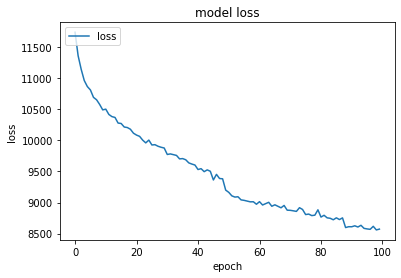

In [15]:
def plotLoss(history):
    plt.plot(history.history['loss'])
    plt.title('model loss')
    plt.ylabel('loss')
    plt.xlabel('epoch')
    plt.legend(['loss'],loc='upper left')
#     plt.savefig('./')
    plt.show()

plotLoss(history)

In [16]:
pred = model.predict(x_train[0:64], batch_size=1)
test_img_predictions_rgb = []
test_abs_predicted = decode_ab(pred)

/opt/conda/lib/python3.7/site-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 4 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))
/opt/conda/lib/python3.7/site-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 3 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))
/opt/conda/lib/python3.7/site-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 1 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))


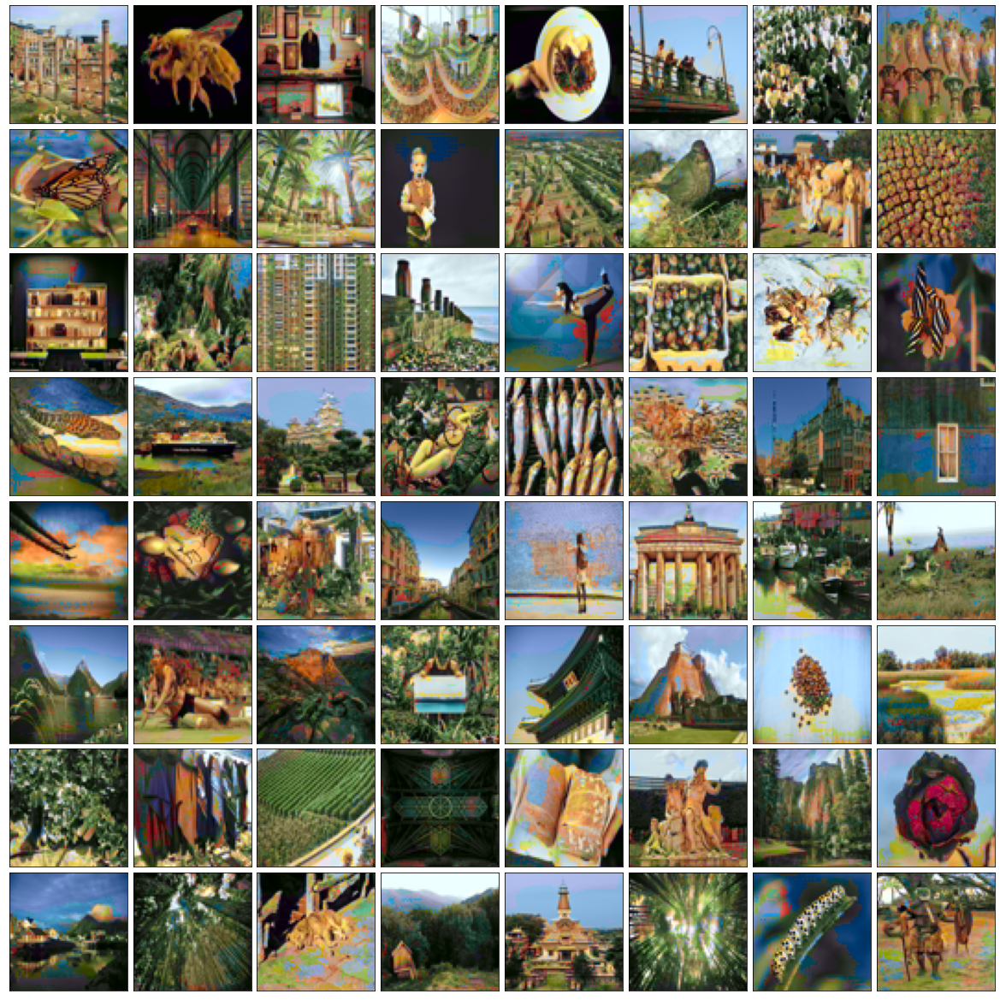

In [17]:
plot_imgs(x_train[0:64], test_abs_predicted)
train_true = decode_ab(train_abs_onehot)
# plot_imgs(train_ls[0:64], train_true[0:64])

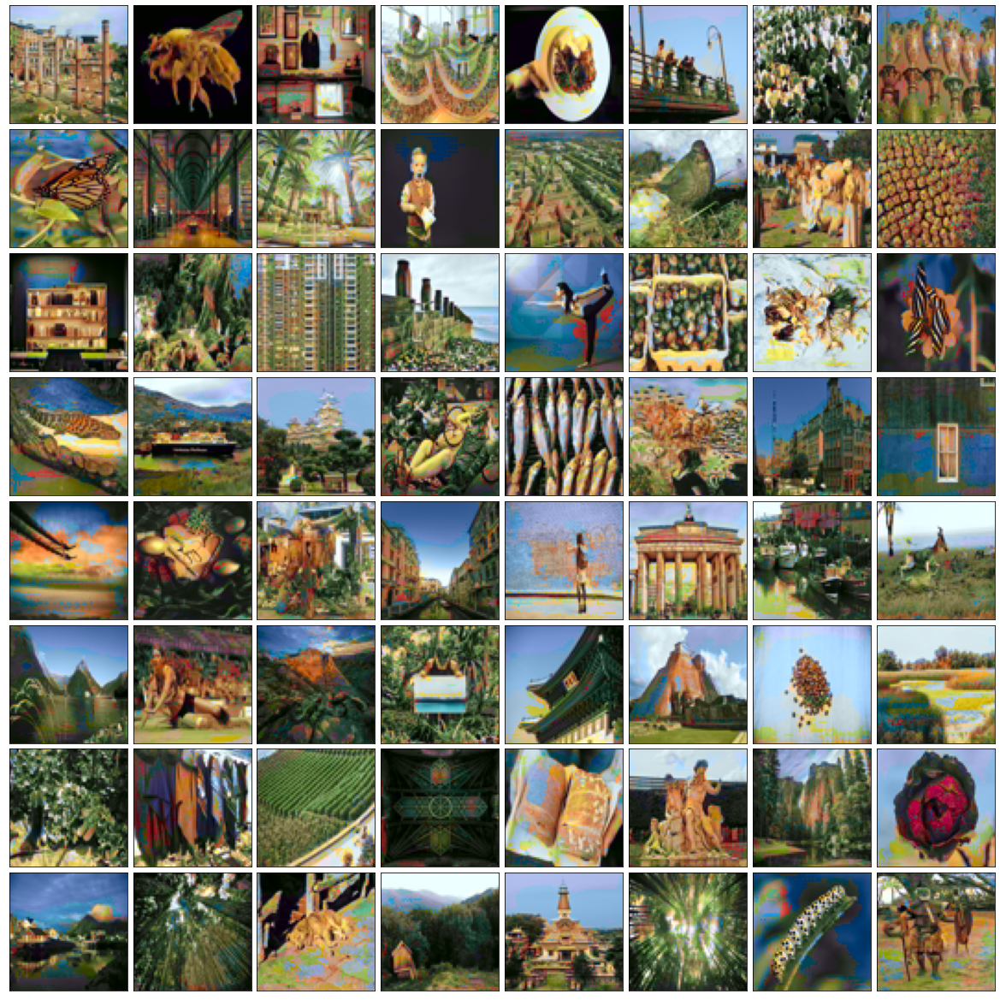

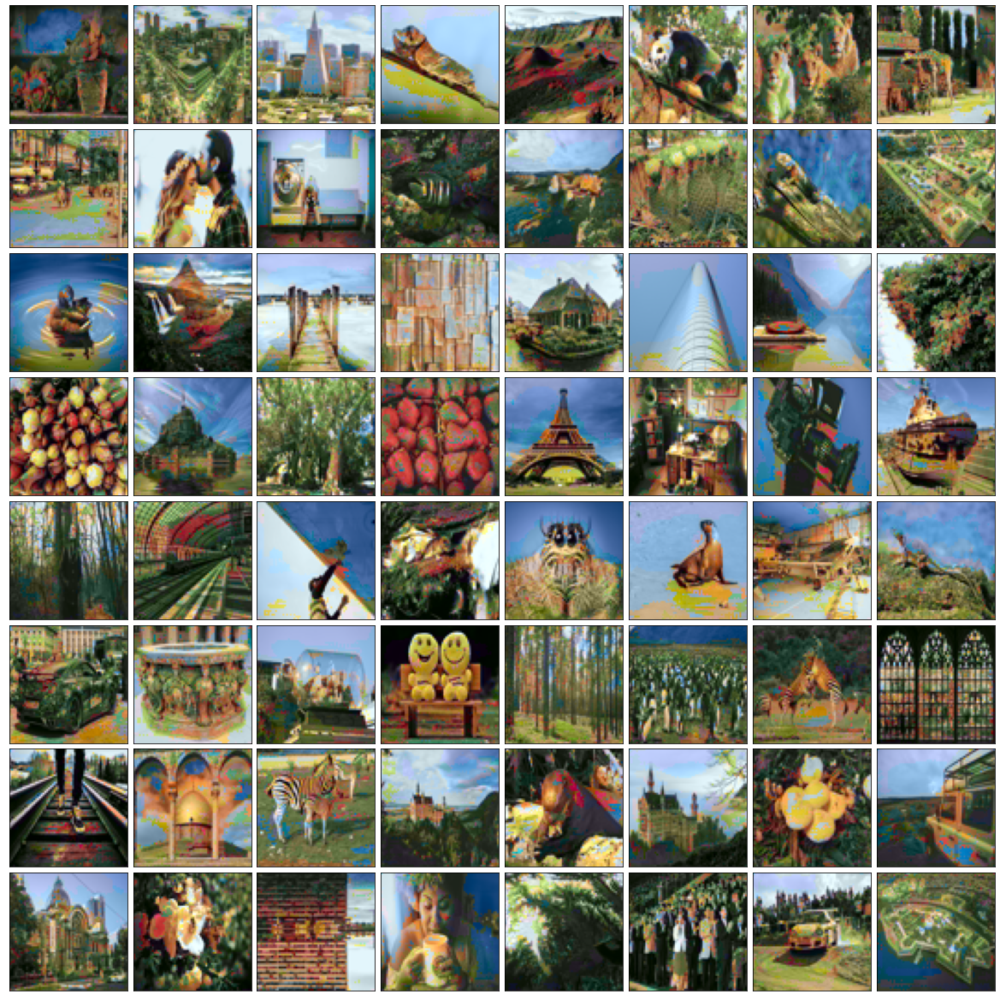

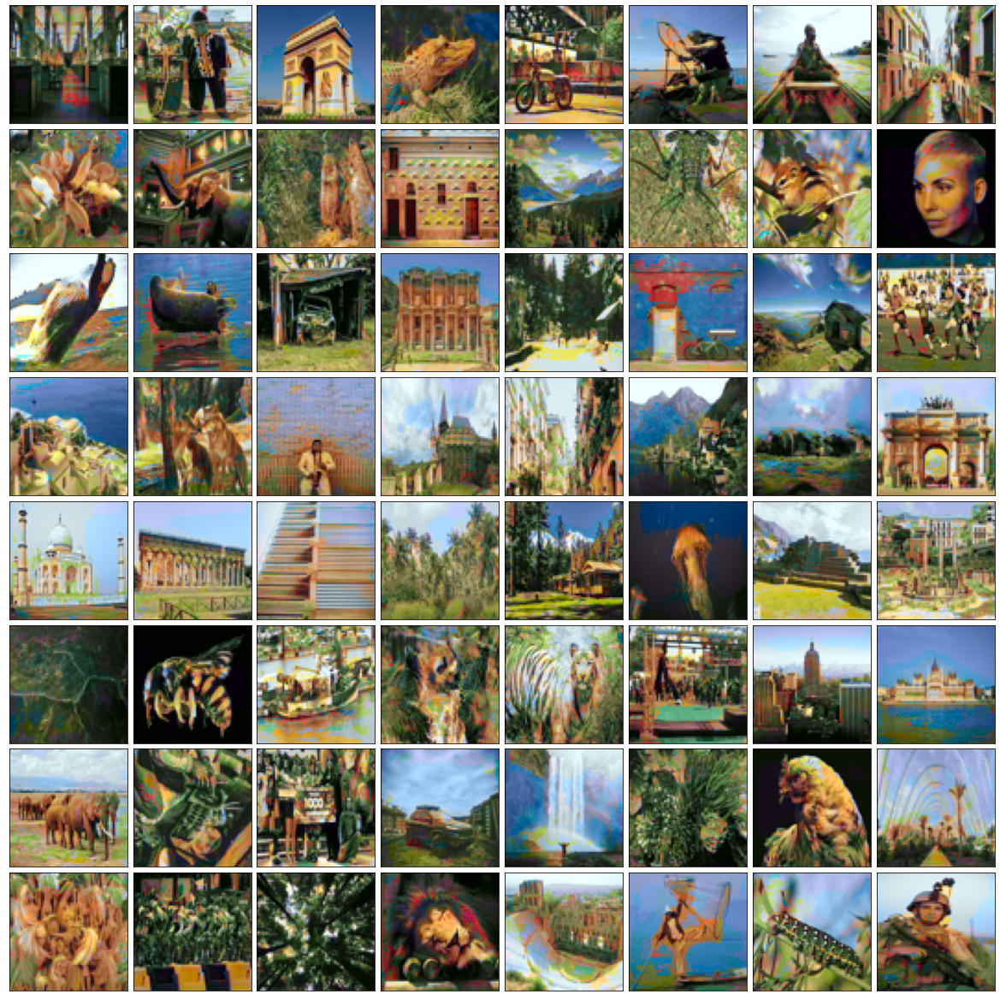

/opt/conda/lib/python3.7/site-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 2 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))


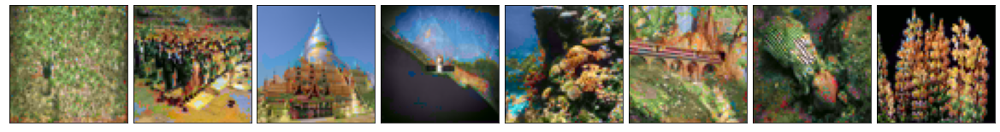

In [18]:
for i in range(0,len(x_train),64):
    start=i
    end=min(i+64,len(x_train))
    pred = model.predict(x_train[start:end], batch_size=1)
    test_img_predictions_rgb = []
    test_abs_predicted = decode_ab(pred)
    plot_imgs(x_train[start:end], test_abs_predicted)

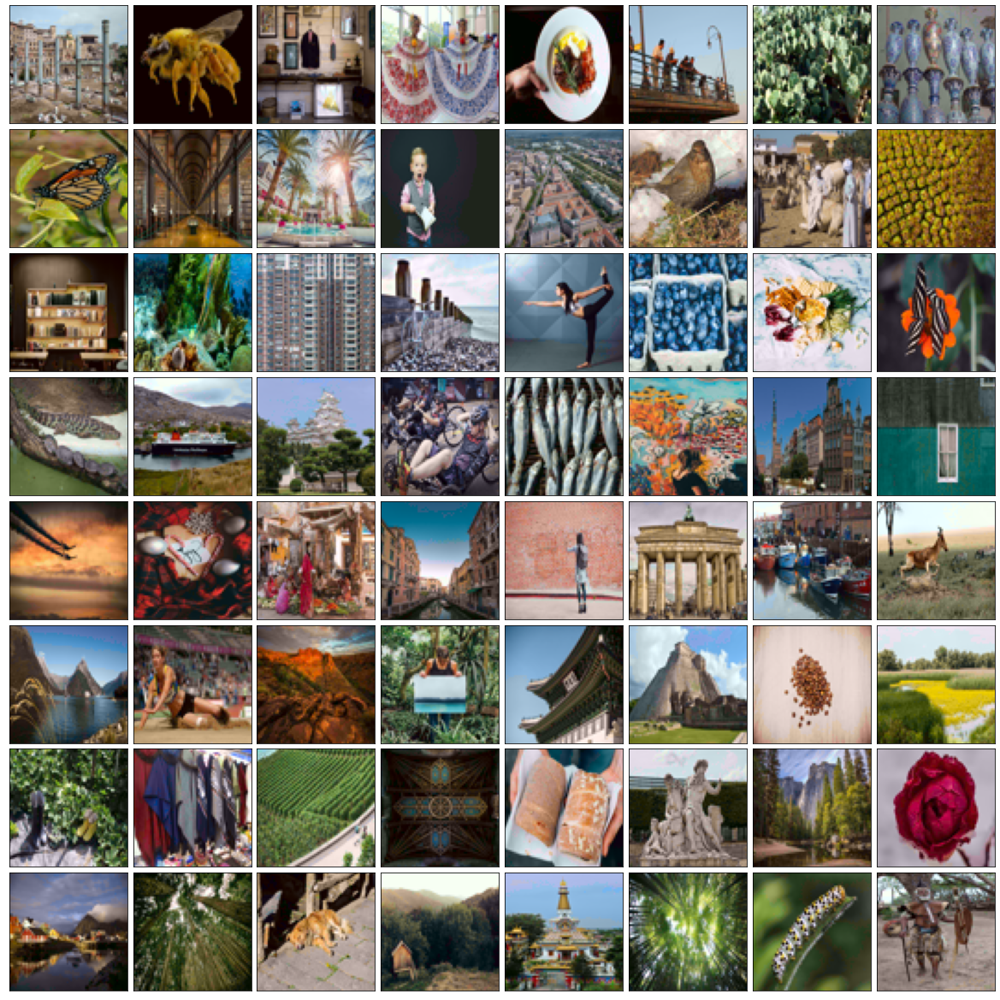

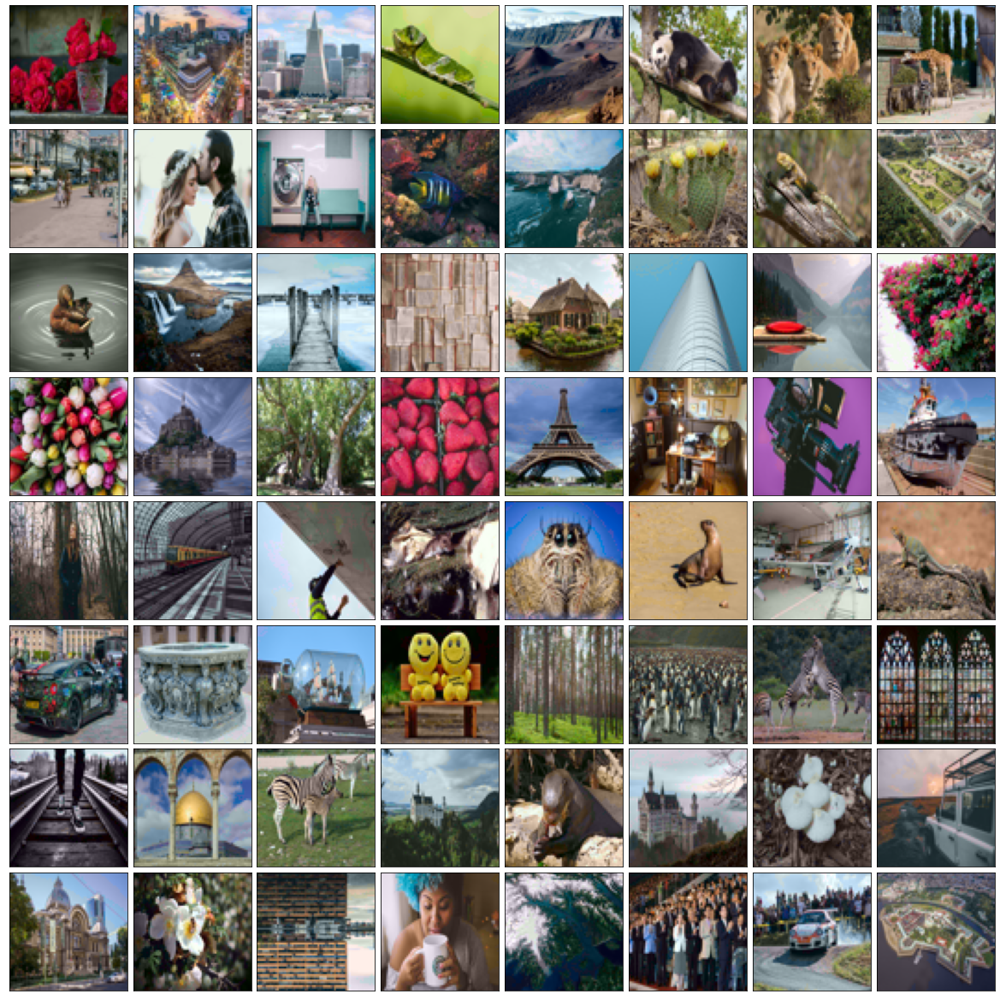

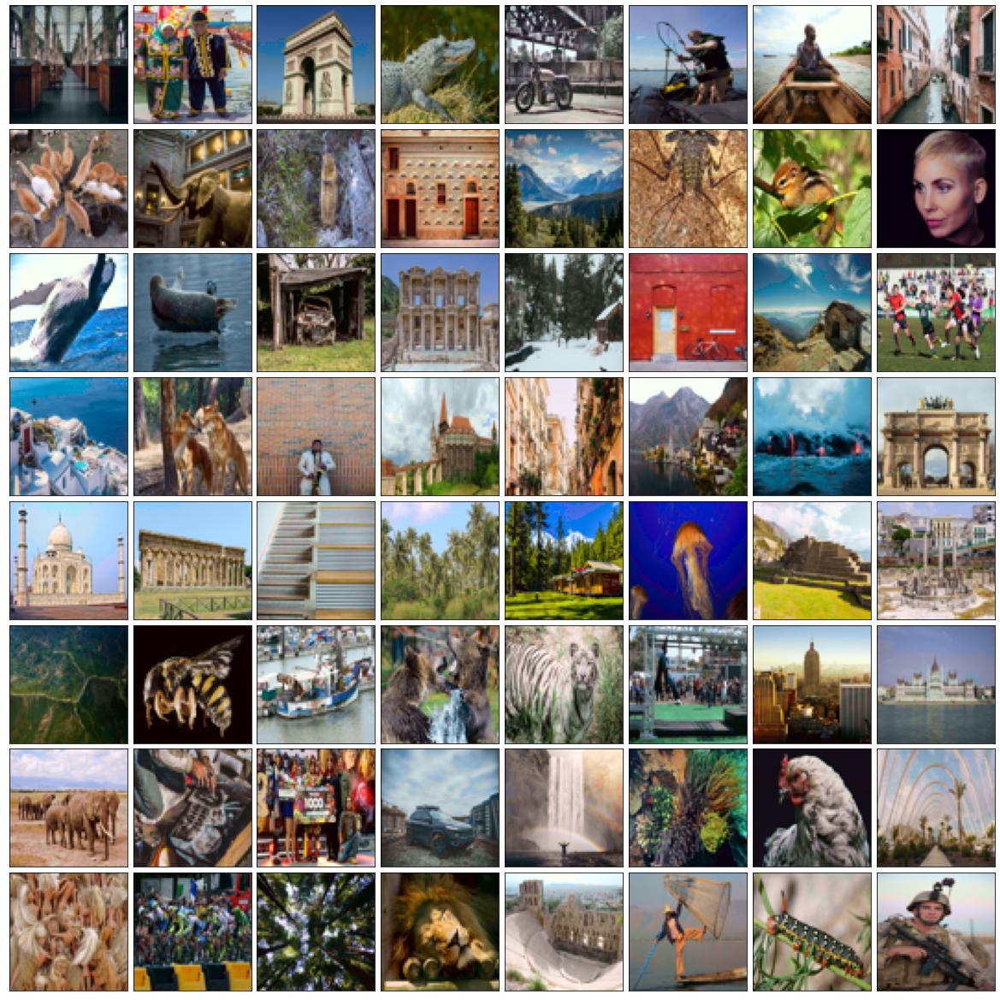

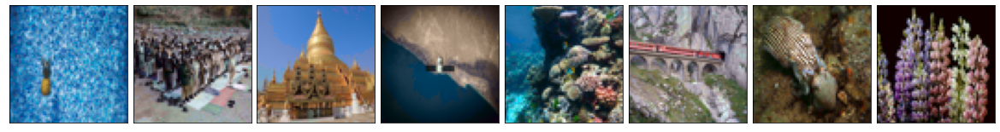

In [20]:
for i in range(0,len(x_train),64):
    start=i
    end=min(i+64,len(x_train))
    train_true = decode_ab(train_abs_onehot)
    plot_imgs(train_ls[start:end], train_true[start:end])